In [22]:
import SIMSIToolBox
import matplotlib.pyplot as plt
import os
import pandas as pd
import numpy as np
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from copy import deepcopy
import umap
from sklearn.cluster import KMeans
import pickle as pkl
import molmass
import SIMSIToolBox.recalibration
import importlib
importlib.reload(SIMSIToolBox)
import seaborn as sb

In [23]:
datadir = "X:/MSI_Shared_Data/13CImagingManuscript/raw_data/non-perfused/desi/13C/"

In [24]:
peaklist = pd.read_csv(datadir + "../30092022_desi_targets_annotated.csv")
peaklist

,datasetName,formula,adduct,chemMod,ion,mz,moleculeNames,moleculeIds,meanM0,clean,for_paper,ccs
0,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C32H36N4O5,M-H,NaN,C32H36N4O5-H-,555.261215,Quinidine barbiturate,HMDB0015436,0.999988,1,0,-1.0
1,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C33H36N2O6,M-H,NaN,C33H36N2O6-H-,555.249982,Dipiperamide C,HMDB0039457,0.999691,1,0,-1.0
2,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C14H28O2,M-H,NaN,C14H28O2-H-,227.201575,"12-Methyltridecanoic acid, Hexanal octane-1,3-...","HMDB0031072, HMDB0032318, HMDB0000806, HMDB000...",0.999609,1,0,-1.0
3,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C3H6O3,M-H,NaN,C3H6O3-H-,89.024339,"Monoethyl carbonate, Dimethyl carbonate, Dihyd...","HMDB0031232, HMDB0029580, HMDB0001882, HMDB000...",0.999546,1,0,-1.0
4,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C17H34O2,M-H,NaN,C17H34O2-H-,269.248525,"Nonyl octanoate, Heptadecanoic acid, (S)-14-Me...","HMDB0034131, HMDB0002259, HMDB0031067, HMDB003...",0.999047,1,0,-1.0
5,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C15H30O2,M-H,NaN,C15H30O2-H-,241.217225,"Dodecyl propionate, Hexyl nonanoate, Pentadeca...","HMDB0032250, HMDB0032328, HMDB0000826, HMDB003...",0.998841,1,0,-1.0
6,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C19H22O3,M-H,NaN,C19H22O3-H-,297.149540,"Gravelliferone, 5-Hydroxy-7-(4-hydroxyphenyl)-...","HMDB0030729, HMDB0033711, HMDB0034054, HMDB004...",0.997415,1,0,-1.0
7,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C21H26O3,M-H,NaN,C21H26O3-H-,325.180840,"Isoacitretin, Acitretin","HMDB0003039, HMDB0014602",0.996826,1,0,-1.0
8,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C16H32O2,M-H,NaN,C16H32O2-H-,255.232875,"Butyl dodecanoate, Dodecyl butyrate, Hexyl dec...","HMDB0032065, HMDB0032249, HMDB0032324, HMDB000...",0.995917,1,1,168.7
9,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C10H14N5O7P,M-H,NaN,C10H14N5O7P-H-,346.055729,"Adenosine monophosphate, 2'-Deoxyguanosine 5'-...","HMDB0000045, HMDB0001044, HMDB0003540, HMDB001...",0.994711,1,1,174.1


In [59]:
ppmThresh = 10
num_cores = 20
intensityCutoff = 0
convSquare = 3 #size of filter (1=1x1,3=3x3,5=5x5)
colormap = LinearSegmentedColormap.from_list("test",colors=["black", "navy","blue","cyan","yellow","orange","orangered","red","mistyrose","white"],N=256)
dm_method = "PCA" #method for dimensionality reduction ("PCA" or "TSNE") PCA has worked better for me
seg_method = "K_means" #thresholding method ("TIC_auto", "K_means", "TIC_manual")
num_components = 2 #number of compoents to use with PCA or TSNE
filtMethod = "GB" #filtering method (GB = gaussian blur, MA = moving average)

In [26]:
mzsCorr = list(peaklist["mz"].values)
mzsCorr.sort()

In [27]:
if __name__ == "__main__":
    tolerance = 0.10
    step = 0.002
    dalim = 0.05
    files = [x for x in os.listdir(datadir) if ".imzml" in x and "recal" not in x]
    for file in files:
        if file.replace(".imzml","_recal.imzML") not in os.listdir(datadir):
            print(file)
            SIMSIToolBox.recalibration.write_corrected_msi(datadir + file,datadir + file.replace(".imzml","_recal.imzML"),tolerance,mzsCorr,step,dalim,numCores=num_cores)



20221031_mt_tumor_brain4-4_13D_13C_10um_70-560mz Analyte 1_1.imzml
reading spectra...

c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\pyimzml\ontology\ontology.py:94: UserWarning: Accession MS:1000526 found with incorrect name "Waters raw file". Updating name to "Waters raw format".
  % (accession, raw_name, name)
c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\pyimzml\ontology\ontology.py:94: UserWarning: Accession IMS:1000042 found with incorrect name "max count of pixel x". Updating name to "max count of pixels x".
  % (accession, raw_name, name)
c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\pyimzml\ontology\ontology.py:94: UserWarning: Accession IMS:1000043 found with incorrect name "max count of pixel y". Updating name to "max count of pixels y".
  % (accession, raw_name, name)
c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\pyimzml\ontology\ontology.py:94: UserWarning: Accession IMS:1000046 found with incorrect name "pixel size". Updating name to "pixel size (x)".
  %

done
correcting spectra |██████████████████████████████████████████████████| 100.0% 
corrected 100.0% of pixels
writing spectra...done


In [28]:
mzs = []
keys = []
for index,row in peaklist.iterrows():
    _,_,nC = SIMSIToolBox.getMzsOfIsotopologues(row["formula"],"C")
    for x in range(nC+1):
        mzs.append(row["mz"] + 1.00336 * x)
        keys.append((index,x))
print(len(mzs))

376


In [29]:
inds = []
for index,row in peaklist.iterrows():
    tmp = [x for x in range(len(keys)) if keys[x][0] == index]
    tmp.sort(key=lambda x: keys[x][1])
    inds.append(tmp)
peaklist["inds"] = inds
peaklist

,datasetName,formula,adduct,chemMod,ion,mz,moleculeNames,moleculeIds,meanM0,clean,for_paper,ccs,inds
0,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C32H36N4O5,M-H,NaN,C32H36N4O5-H-,555.261215,Quinidine barbiturate,HMDB0015436,0.999988,1,0,-1.0,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,..."
1,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C33H36N2O6,M-H,NaN,C33H36N2O6-H-,555.249982,Dipiperamide C,HMDB0039457,0.999691,1,0,-1.0,"[33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 4..."
2,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C14H28O2,M-H,NaN,C14H28O2-H-,227.201575,"12-Methyltridecanoic acid, Hexanal octane-1,3-...","HMDB0031072, HMDB0032318, HMDB0000806, HMDB000...",0.999609,1,0,-1.0,"[67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 7..."
3,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C3H6O3,M-H,NaN,C3H6O3-H-,89.024339,"Monoethyl carbonate, Dimethyl carbonate, Dihyd...","HMDB0031232, HMDB0029580, HMDB0001882, HMDB000...",0.999546,1,0,-1.0,"[82, 83, 84, 85]"
4,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C17H34O2,M-H,NaN,C17H34O2-H-,269.248525,"Nonyl octanoate, Heptadecanoic acid, (S)-14-Me...","HMDB0034131, HMDB0002259, HMDB0031067, HMDB003...",0.999047,1,0,-1.0,"[86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 9..."
5,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C15H30O2,M-H,NaN,C15H30O2-H-,241.217225,"Dodecyl propionate, Hexyl nonanoate, Pentadeca...","HMDB0032250, HMDB0032328, HMDB0000826, HMDB003...",0.998841,1,0,-1.0,"[104, 105, 106, 107, 108, 109, 110, 111, 112, ..."
6,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C19H22O3,M-H,NaN,C19H22O3-H-,297.149540,"Gravelliferone, 5-Hydroxy-7-(4-hydroxyphenyl)-...","HMDB0030729, HMDB0033711, HMDB0034054, HMDB004...",0.997415,1,0,-1.0,"[120, 121, 122, 123, 124, 125, 126, 127, 128, ..."
7,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C21H26O3,M-H,NaN,C21H26O3-H-,325.180840,"Isoacitretin, Acitretin","HMDB0003039, HMDB0014602",0.996826,1,0,-1.0,"[140, 141, 142, 143, 144, 145, 146, 147, 148, ..."
8,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C16H32O2,M-H,NaN,C16H32O2-H-,255.232875,"Butyl dodecanoate, Dodecyl butyrate, Hexyl dec...","HMDB0032065, HMDB0032249, HMDB0032324, HMDB000...",0.995917,1,1,168.7,"[162, 163, 164, 165, 166, 167, 168, 169, 170, ..."
9,20220930_01_202w145h_05H_mt_tumor_brain1-5_12C...,C10H14N5O7P,M-H,NaN,C10H14N5O7P-H-,346.055729,"Adenosine monophosphate, 2'-Deoxyguanosine 5'-...","HMDB0000045, HMDB0001044, HMDB0003540, HMDB001...",0.994711,1,1,174.1,"[179, 180, 181, 182, 183, 184, 185, 186, 187, ..."


extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 
extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 
extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 


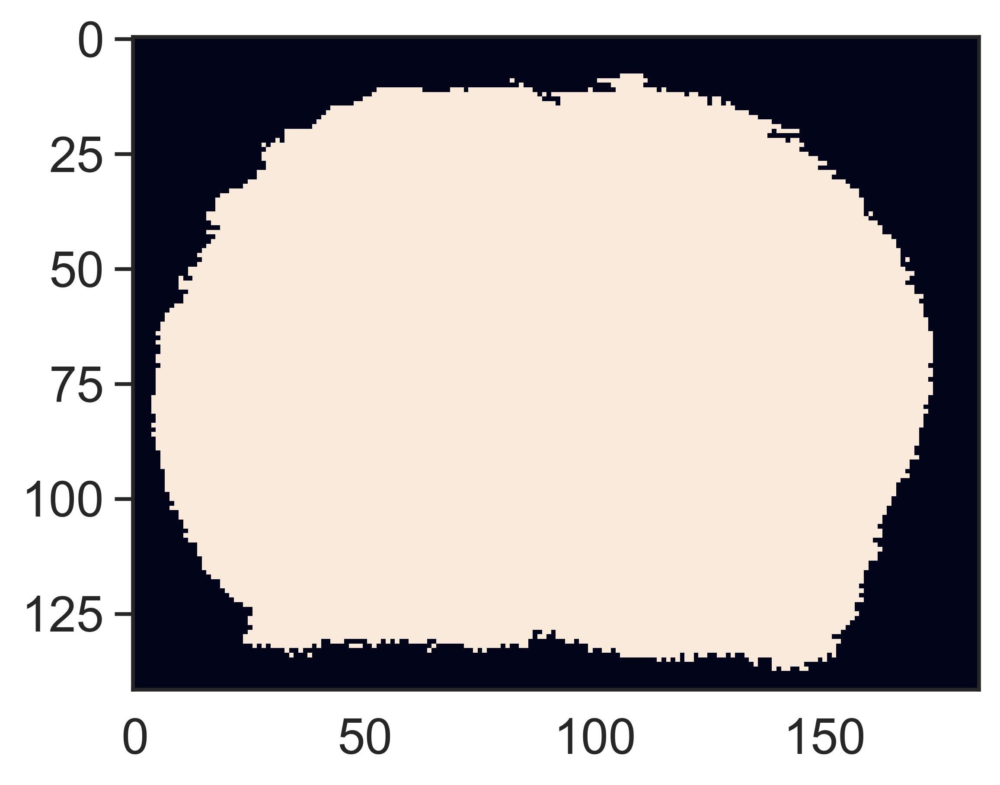

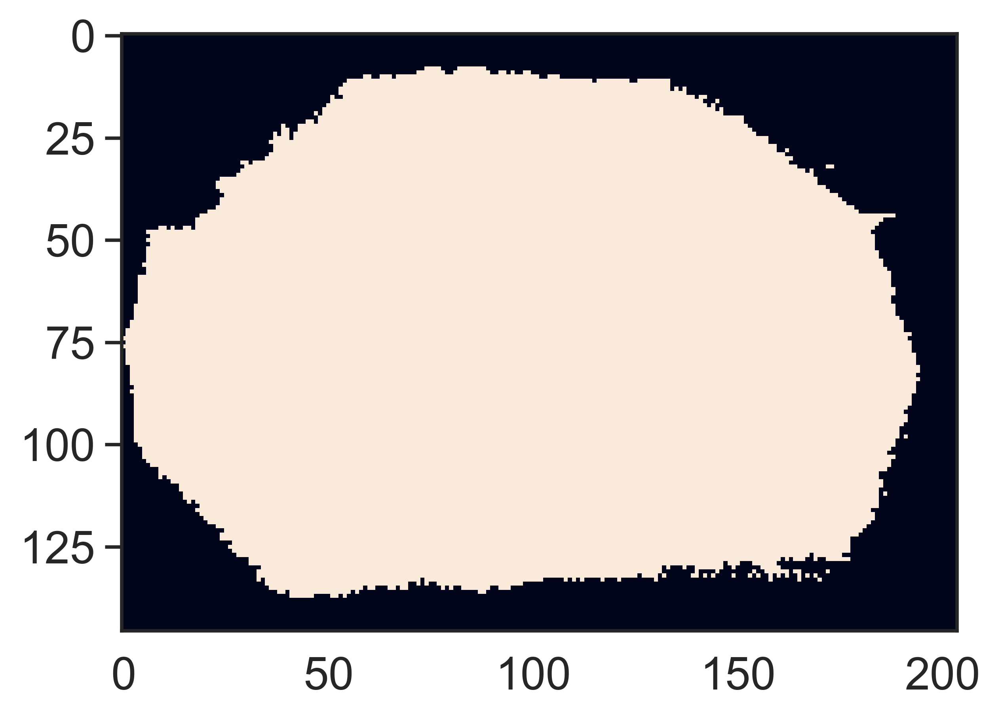

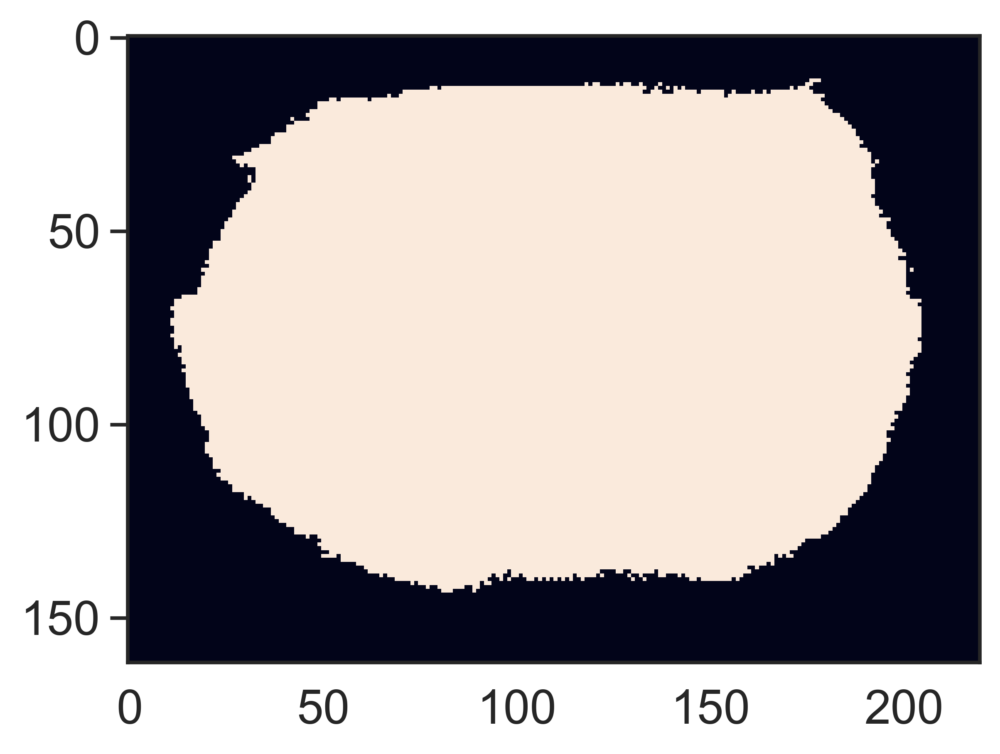

In [45]:
if __name__ == "__main__":
    msis = {}
    files = [x for x in os.listdir(datadir) if "_recal.imzML" in x]
    for file in files:
        msi = SIMSIToolBox.MSIData(mzs,ppm=ppmThresh,numCores = num_cores,intensityCutoff=intensityCutoff)
        msi.readimzML(datadir + file)
        msi.segmentImage(method=seg_method, num_latent=num_components, dm_method=dm_method,fill_holes = True)
        plt.close()
        plt.figure()
        plt.imshow(msi.imageBoundary)
        msi.smoothData(filtMethod,convSquare)
        msi.correctNaturalAbundance(peaklist["formula"].values,peaklist["inds"].values)
        msis[file] = msi



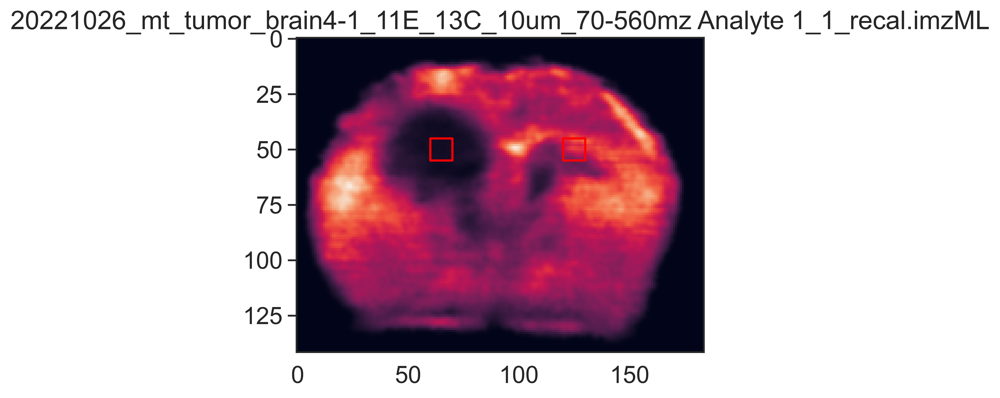

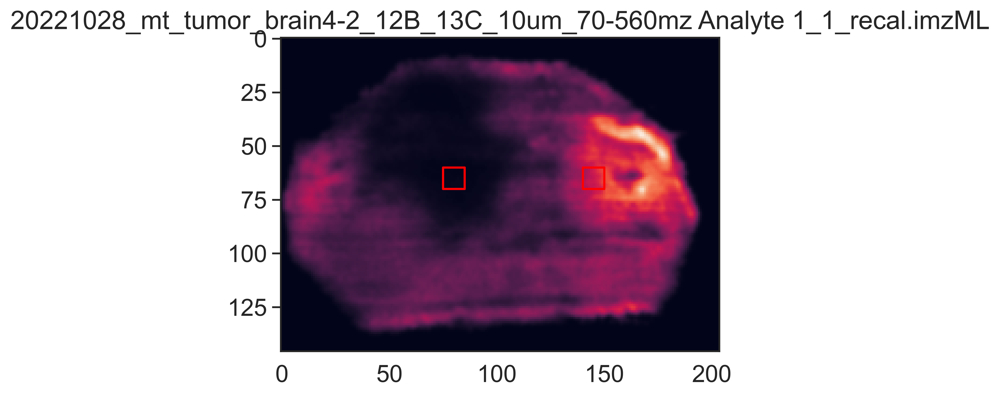

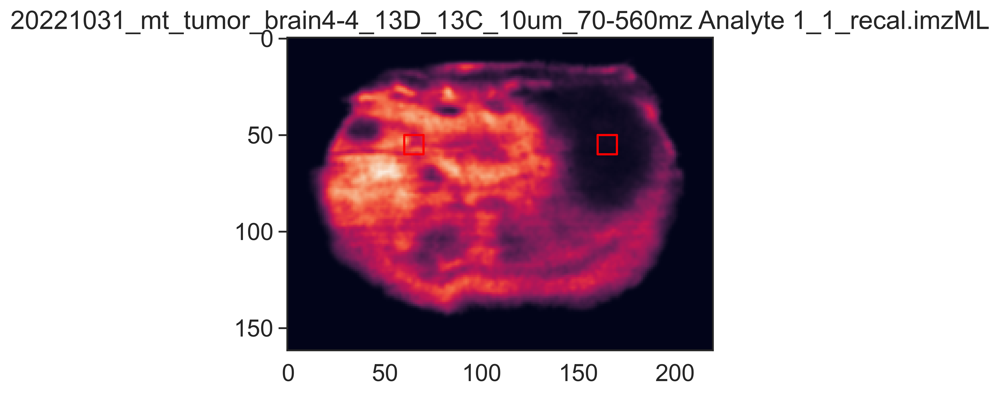

In [46]:
boxSize = 10
boxBoundaries = {'20221026_mt_tumor_brain4-1_11E_13C_10um_70-560mz Analyte 1_1_recal.imzML':{"i":[[60,60+boxSize],[45,45+boxSize]],"c":[[120,120+boxSize],[45,45+boxSize]]},
                        '20221028_mt_tumor_brain4-2_12B_13C_10um_70-560mz Analyte 1_1_recal.imzML':{"i":[[75,75+boxSize],[60,60+boxSize]],"c":[[140,140+boxSize],[60,60+boxSize]]},
                        "20221031_mt_tumor_brain4-4_13D_13C_10um_70-560mz Analyte 1_1_recal.imzML":{"i":[[160,160+boxSize],[50,50+boxSize]],"c":[[60,60+boxSize],[50,50+boxSize]]}}
naaInds = [369, 370, 371, 372, 373, 374, 375]
def plotBox(xmin,xmax,ymin,ymax,color):
    plt.plot([xmin,xmax],[ymin,ymin],color)
    plt.plot([xmin,xmax],[ymax,ymax],color)
    plt.plot([xmin,xmin],[ymin,ymax],color)
    plt.plot([xmax,xmax],[ymin,ymax],color)
    
def addBox(xmin,xmax,ymin,ymax,color,image):
    image = deepcopy(image)
    image[xmin:xmax+1,ymin] = color
    image[xmin:xmax+1,ymax] = color
    image[xmin,ymin:ymax+1] = color
    image[xmax,ymin:ymax+1] = color
    return image

for fn in msis:
    plt.figure()
    plt.imshow(msis[fn].data_tensor[naaInds,:,:].sum(axis=0))
    plt.title(fn)    

    box1 = boxBoundaries[fn]["i"]
    box2 = boxBoundaries[fn]["c"]

    plotBox(*box1[0],*box1[1],"red")
    plotBox(*box2[0],*box2[1],"red")


In [47]:
molsOfInterest = ["C16H32O2","C18H36O2"]

In [48]:
def getMeanValueFromBox(arr,xmin,xmax,ymin,ymax):
    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(arr[x,y])
    roi = np.array(roi)
    return np.mean(roi)

Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 


,palmitate_g,palmitate_x0,palmitate_x1,palmitate_x2,palmitate_g_lh,palmitate_x0_lh,palmitate_x1_lh,palmitate_x2_lh,palmitate_g_rh,palmitate_x0_rh,...,stearate_g_lh,stearate_e_lf,stearate_x0_lh,stearate_x1_lh,stearate_x2_lh,stearate_g_rh,stearate_e_rh,stearate_x0_rh,stearate_x1_rh,stearate_x2_rh
20221026_mt_tumor_brain4-1_11E_13C_10um_70-560mz Analyte 1_1_recal.imzML,0.086162,0.354754,0.077106,0.568140,0.055591,0.320190,0.063896,0.525005,0.109282,0.374643,...,0.026123,0.050483,0.245165,0.209004,0.454922,0.075578,0.056285,0.332565,0.224894,0.442541
20221028_mt_tumor_brain4-2_12B_13C_10um_70-560mz Analyte 1_1_recal.imzML,0.126392,0.377010,0.082363,0.540627,0.097627,0.340205,0.072128,0.587667,0.168640,0.368974,...,0.041015,0.072473,0.251244,0.273308,0.475448,0.120480,0.104935,0.388496,0.170687,0.440817
20221031_mt_tumor_brain4-4_13D_13C_10um_70-560mz Analyte 1_1_recal.imzML,0.158543,0.338843,0.078975,0.582134,0.174607,0.357217,0.084660,0.558123,0.148625,0.340491,...,0.131141,0.079901,0.376625,0.123369,0.500006,0.057946,0.063398,0.315472,0.124617,0.559911


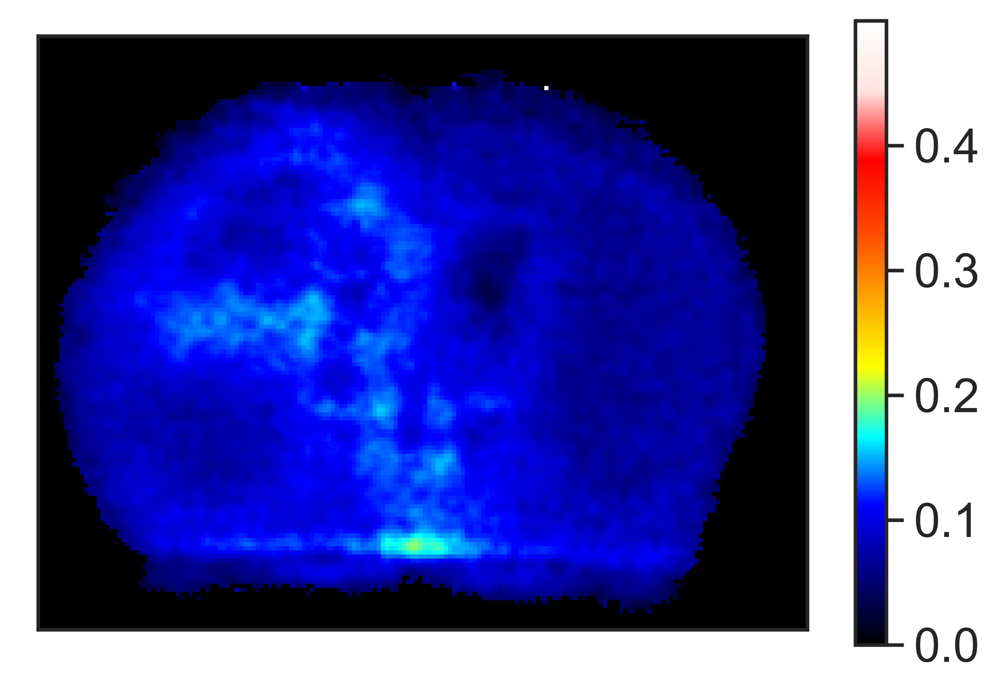

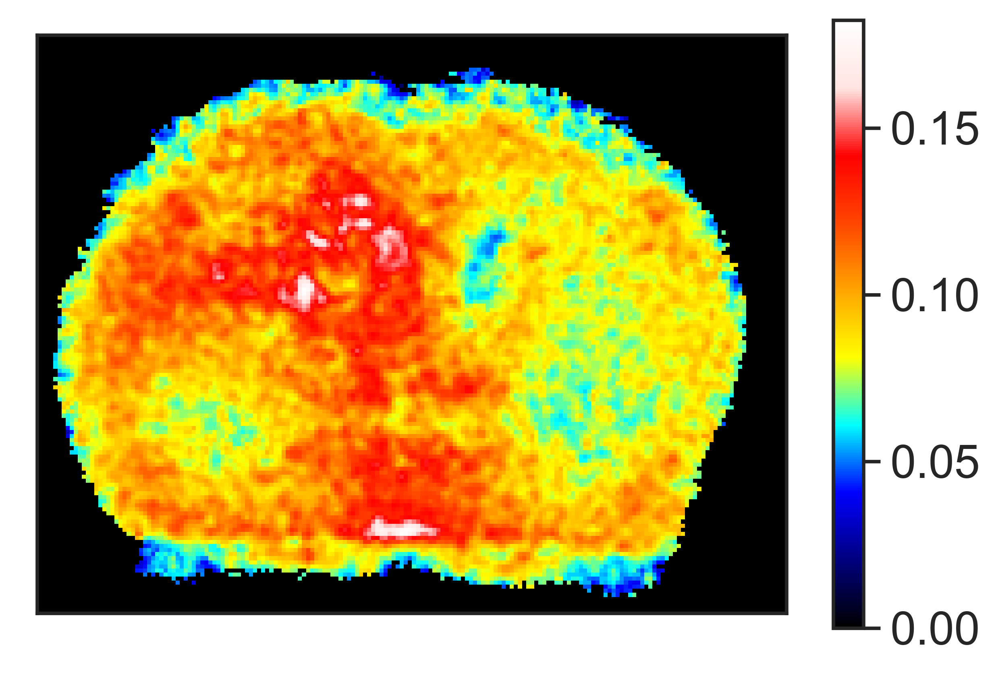

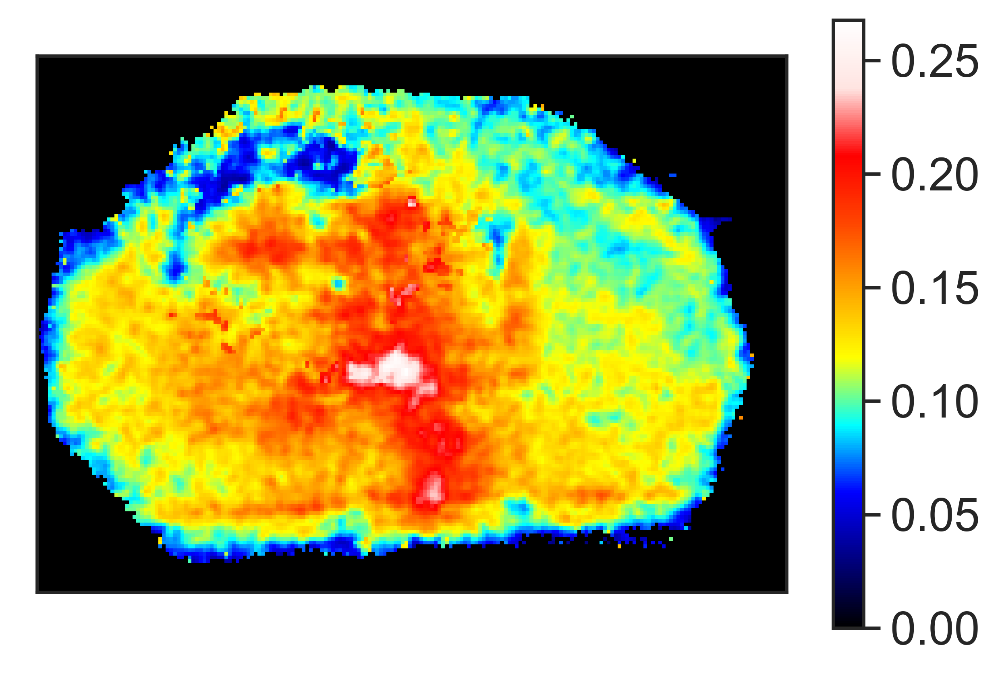

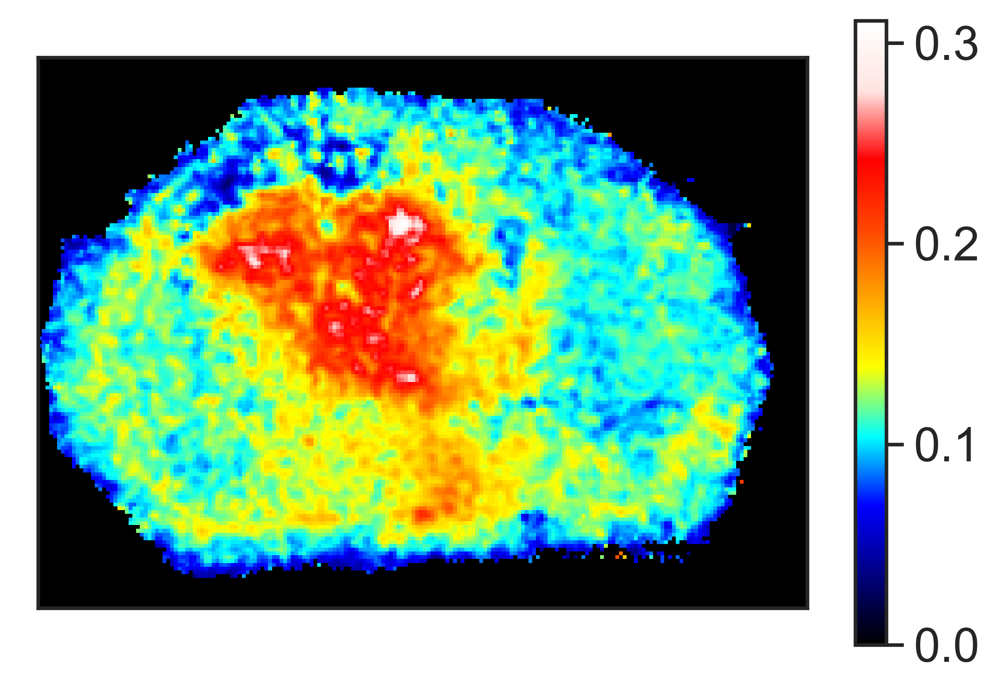

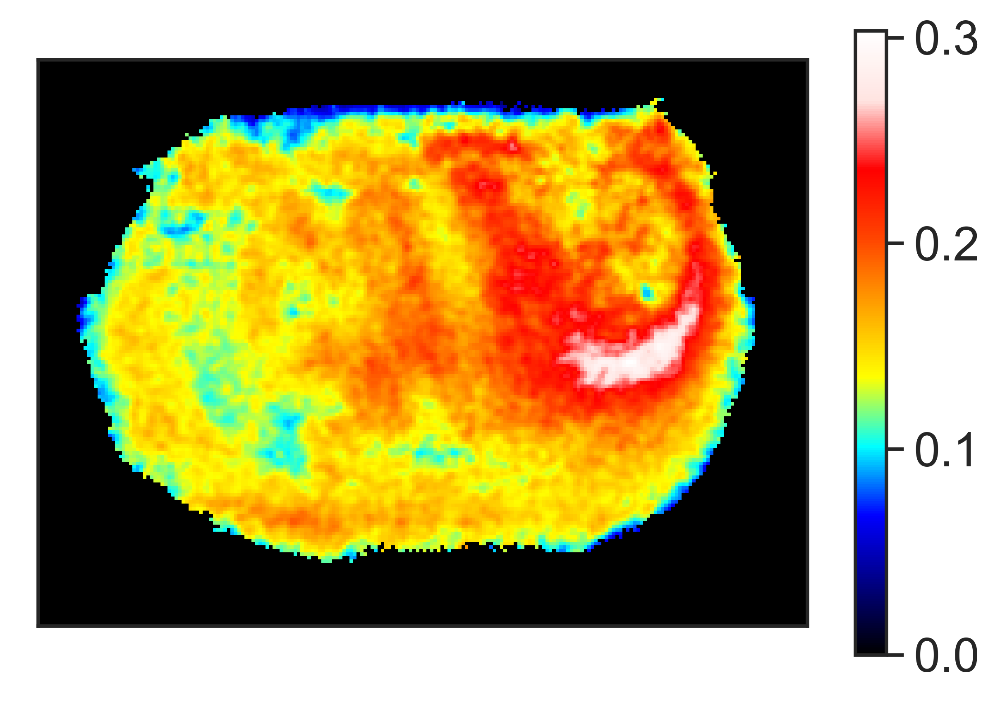

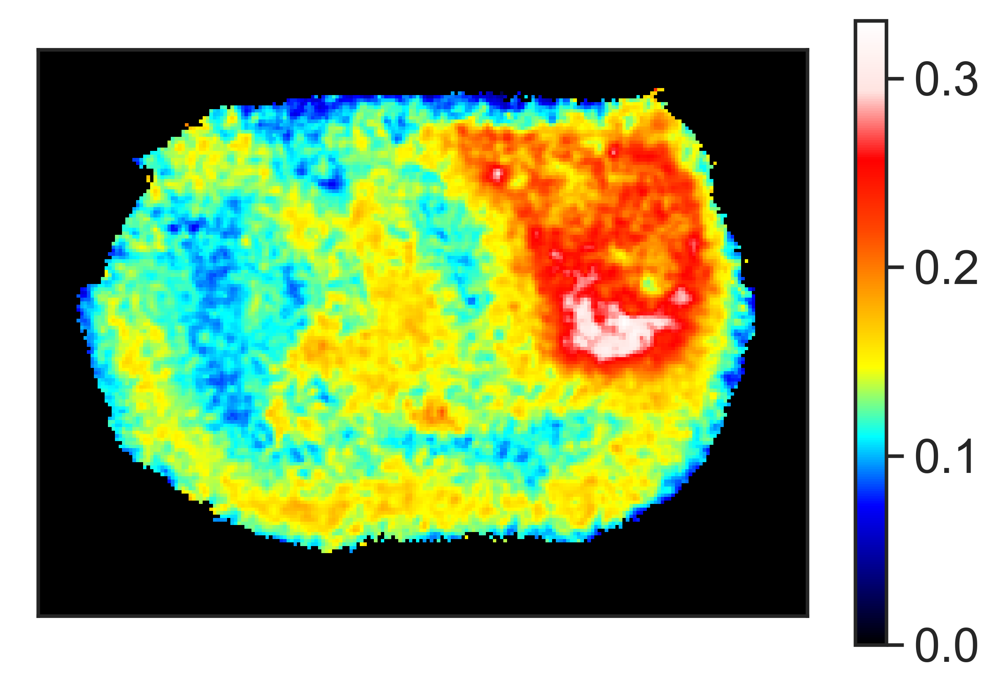

In [49]:
for fn in msis:
    try: os.mkdir(datadir + fn.replace(".imzML",""))
    except: pass
    
badIndsPal = [1,4,5]
badIndsSt = [17]

peaklistFilt = peaklist[peaklist["formula"].isin(molsOfInterest)]
peaklistFilt = peaklistFilt.sort_values(by="mz",ascending=True)

fluxImages = {}
meanFluxes = {}

if __name__ == "__main__":
    for fn in msis:
        fluxImages[fn] = {}
        meanFluxes[fn] = {}

        palmInd = peaklistFilt.index.values[0]
        stInd = peaklistFilt.index.values[1]

        shape = msis[fn].tic_image.shape
        
        origTensor = deepcopy(msis[fn].data_tensor)

        msis[fn].data_tensor[np.array(peaklistFilt.at[palmInd,"inds"])[badIndsPal]] = np.zeros((len(badIndsPal),shape[0],shape[1]))
        msis[fn].data_tensor[np.array(peaklistFilt.at[stInd,"inds"])[badIndsSt]] = np.zeros((len(badIndsSt),shape[0],shape[1]))

        fluxImageG,fluxImageE,fluxImageD,fluxImageT0,fluxImageT1,fluxImageT2,T_founds,P_trues,P_preds,numFounds,errs,errors = msis[fn].runISA(inds=peaklistFilt.at[palmInd,"inds"],minIso=0,minFrac=0.0,NACorrected=True,)            
        plt.figure()
        SIMSIToolBox.showImage(fluxImageG,cmap=colormap)  
        
        
        meanFluxes[fn]["palmitate_g"] = np.mean(fluxImageG[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["palmitate_x0"] = np.mean(fluxImageT0[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["palmitate_x1"] = np.mean(fluxImageT1[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["palmitate_x2"] = np.mean(fluxImageT2[msis[fn].imageBoundary > 0.5])

        meanFluxes[fn]["palmitate_g_lh"] = getMeanValueFromBox(fluxImageG,*box1[1],*box1[0])
        meanFluxes[fn]["palmitate_x0_lh"] = getMeanValueFromBox(fluxImageT0,*box1[1],*box1[0])
        meanFluxes[fn]["palmitate_x1_lh"] = getMeanValueFromBox(fluxImageT1,*box1[1],*box1[0])
        meanFluxes[fn]["palmitate_x2_lh"] = getMeanValueFromBox(fluxImageT2,*box1[1],*box1[0])

        meanFluxes[fn]["palmitate_g_rh"] = getMeanValueFromBox(fluxImageG,*box2[1],*box2[0])
        meanFluxes[fn]["palmitate_x0_rh"] = getMeanValueFromBox(fluxImageT0,*box2[1],*box2[0])
        meanFluxes[fn]["palmitate_x1_rh"] = getMeanValueFromBox(fluxImageT1,*box2[1],*box2[0])
        meanFluxes[fn]["palmitate_x2_rh"] = getMeanValueFromBox(fluxImageT2,*box2[1],*box2[0])

        fluxImages[fn]["palmitate"] = {"g":fluxImageG,"e":fluxImageE,"d":fluxImageD,"x0":fluxImageT0,"x1":fluxImageT1,"x2":fluxImageT2,"errs":errs}

        fluxImageST,fluxImageE,fluxImageD,fluxImageT0,fluxImageT1,fluxImageT2,T_founds,P_trues,P_preds,numFounds,errs,errors = msis[fn].runISA(isaModel="elongation",inds=peaklistFilt.at[stInd,"inds"],minIso=0,minFrac=0.00,NACorrected=True)
        fluxImages[fn]["stearate"] = {"g":fluxImageST,"e":fluxImageE,"g+e":fluxImageST+fluxImageE,"d":fluxImageD,"x0":fluxImageT0,"x1":fluxImageT1,"x2":fluxImageT2,"errs":errs}

        plt.figure()
        SIMSIToolBox.showImage(fluxImageST + fluxImageE,cmap=colormap)
        
        meanFluxes[fn]["stearate_g"] = np.mean(fluxImageST[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["stearate_e"] = np.mean(fluxImageE[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["stearate_x0"] = np.mean(fluxImageT0[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["stearate_x1"] = np.mean(fluxImageT1[msis[fn].imageBoundary > 0.5])
        meanFluxes[fn]["stearate_x2"] = np.mean(fluxImageT2[msis[fn].imageBoundary > 0.5])

        meanFluxes[fn]["stearate_g_lh"] = getMeanValueFromBox(fluxImageST,*box1[1],*box1[0])
        meanFluxes[fn]["stearate_e_lf"] = getMeanValueFromBox(fluxImageE,*box1[1],*box1[0])
        meanFluxes[fn]["stearate_x0_lh"] = getMeanValueFromBox(fluxImageT0,*box1[1],*box1[0])
        meanFluxes[fn]["stearate_x1_lh"] = getMeanValueFromBox(fluxImageT1,*box1[1],*box1[0])
        meanFluxes[fn]["stearate_x2_lh"] = getMeanValueFromBox(fluxImageT2,*box1[1],*box1[0])

        meanFluxes[fn]["stearate_g_rh"] = getMeanValueFromBox(fluxImageST,*box2[1],*box2[0])
        meanFluxes[fn]["stearate_e_rh"] = getMeanValueFromBox(fluxImageE,*box2[1],*box2[0])
        meanFluxes[fn]["stearate_x0_rh"] = getMeanValueFromBox(fluxImageT0,*box2[1],*box2[0])
        meanFluxes[fn]["stearate_x1_rh"] = getMeanValueFromBox(fluxImageT1,*box2[1],*box2[0])
        meanFluxes[fn]["stearate_x2_rh"] = getMeanValueFromBox(fluxImageT2,*box2[1],*box2[0])

        msis[fn].data_tensor = origTensor

    meanFluxes = pd.DataFrame.from_dict(meanFluxes,orient="index")
meanFluxes

In [50]:
meanFluxes.to_csv(datadir + "average_fluxes.csv")

In [53]:
for fn in fluxImages:
    for mol in fluxImages[fn]:
        for val in ["g","d","e","x0","x1","x2","g+e"]:
            if val in fluxImages[fn][mol]:
                img = fluxImages[fn][mol][val]
                plt.figure()
                SIMSIToolBox.showImage(img,cmap = colormap)
                maxLim = 0.3#np.max(img)
                plt.clim(0,maxLim)
                norm = plt.Normalize(vmin=0, vmax=maxLim)
                norm = colormap(norm(img))
                for row in range(norm.shape[0]):
                    for col in range(norm.shape[1]):
                        if msis[fn].imageBoundary[row,col] < .5:
                            norm[row,col,3] = 0
                plt.imsave(datadir + fn.replace(".imzML","/") + mol + "_" + val + ".png",norm)#,cmap=colormap)
                plt.savefig(datadir + fn.replace(".imzML","/") + mol + "_" + val + "_with_colorbar.png")
                

In [40]:
def extractLabelingPattern(data,xmin,xmax,ymin,ymax):
    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(data[:,x,y])
    roi = np.array(roi)
    
    df  = {}
    for row in roi:
        for x in range(len(row)):
           df[len(df)] = {"isotopologue":"M"+str(x),"Isotopologue Fraction":row[x]}

    df = pd.DataFrame.from_dict(df,orient="index")

    return df

def extractLabelingPatternForStacked(data,xmin,xmax,ymin,ymax):

    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(data[:,x,y])
    roi = np.array(roi)
    
    roi = roi.mean(axis=0)
    
    df  = {}
    for x in range(len(roi)):
       df[len(df)] = {"isotopologue":"M"+str(x),"Isotopologue Fraction":roi[x]}

    df = pd.DataFrame.from_dict(df,orient="index")
    
    df = df.set_index("isotopologue")

    return df

10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide
c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:87: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


10


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:54: RuntimeWarning: invalid value encountered in true_divide


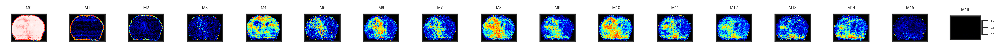

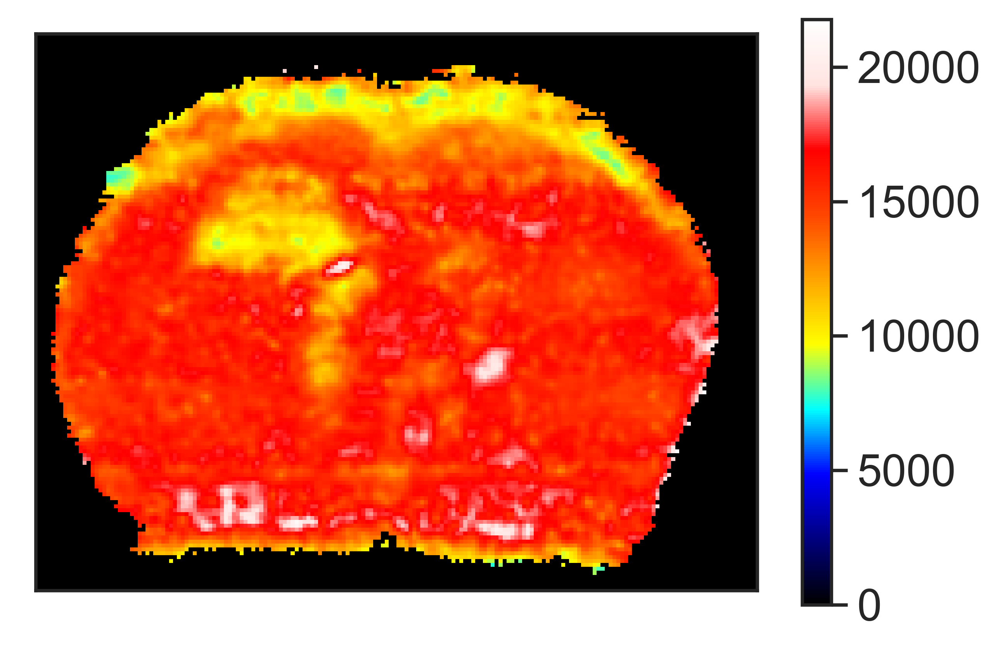

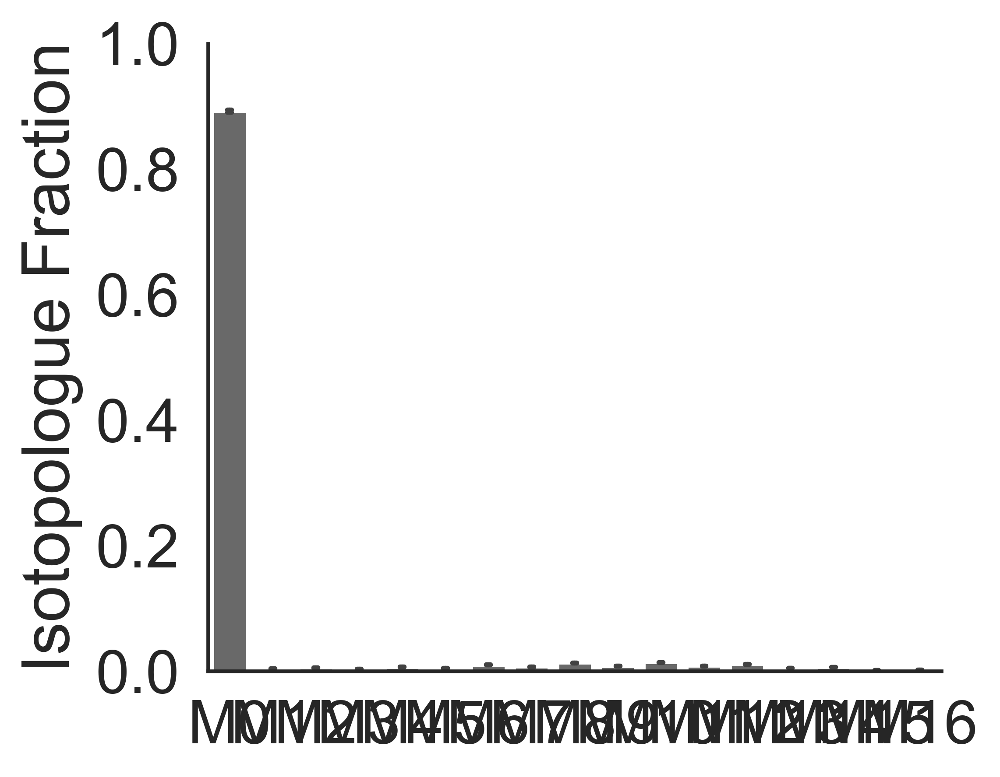

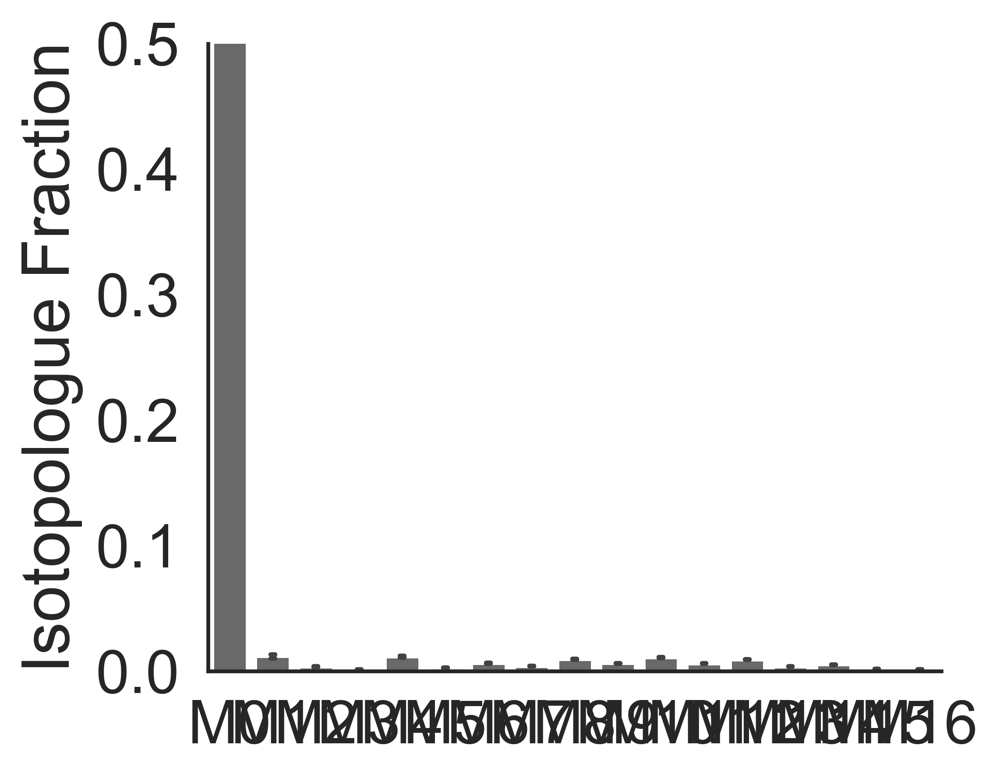

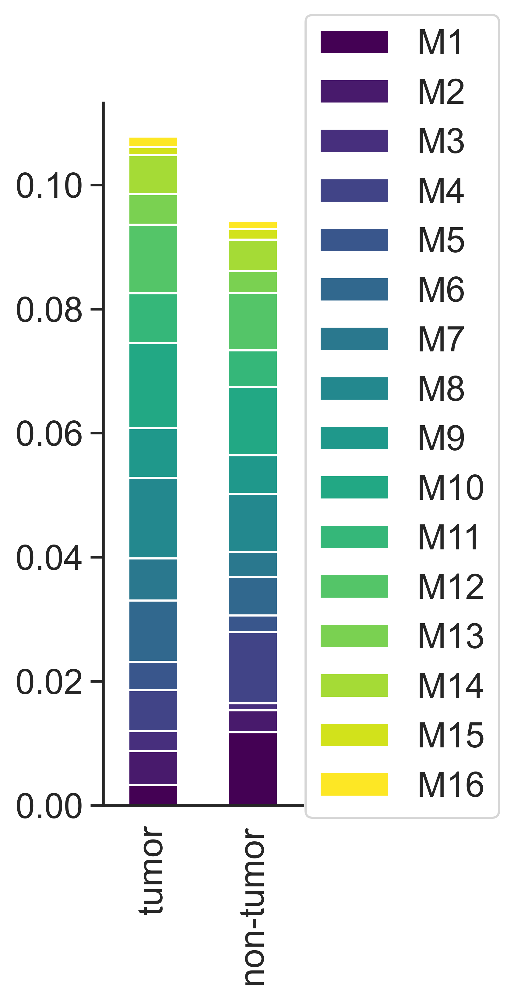

...

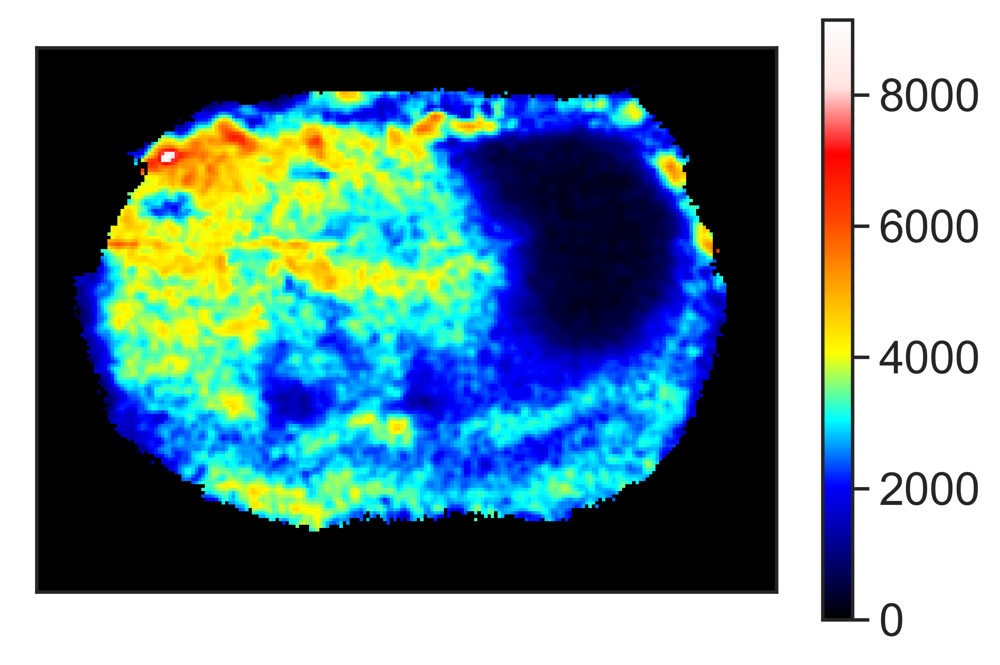

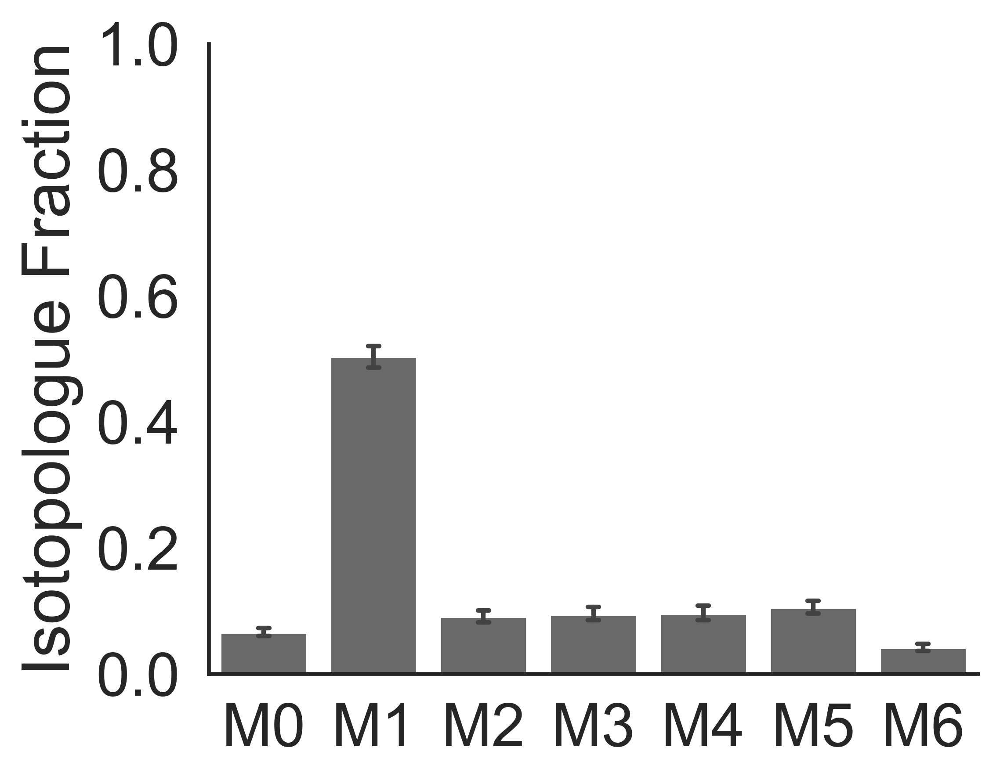

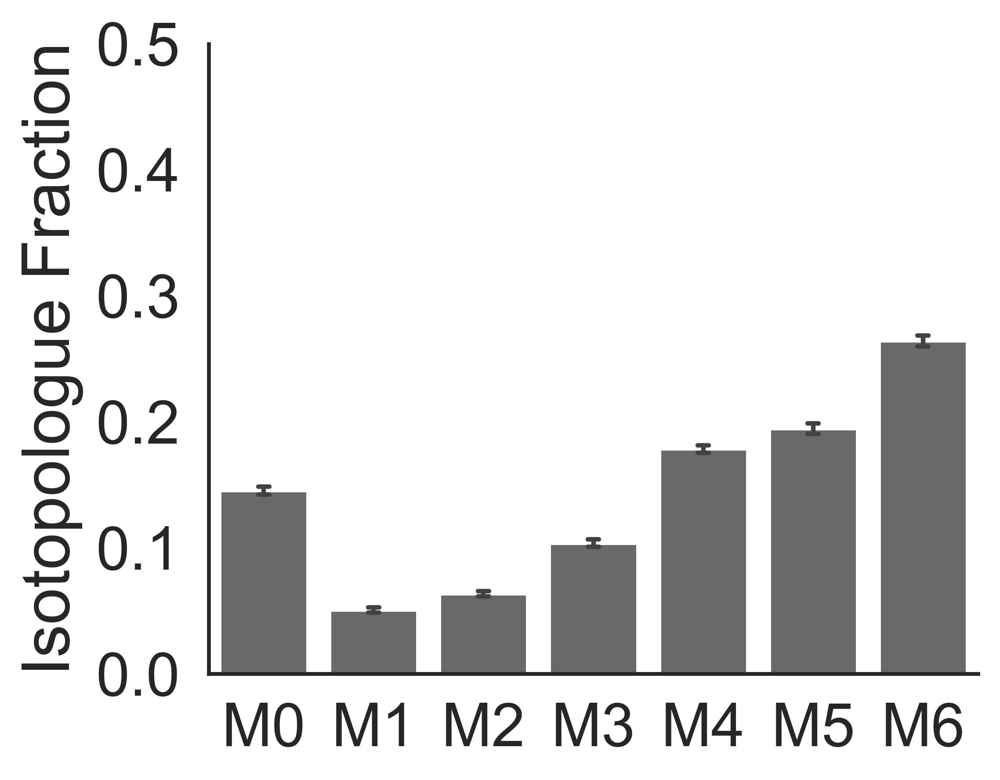

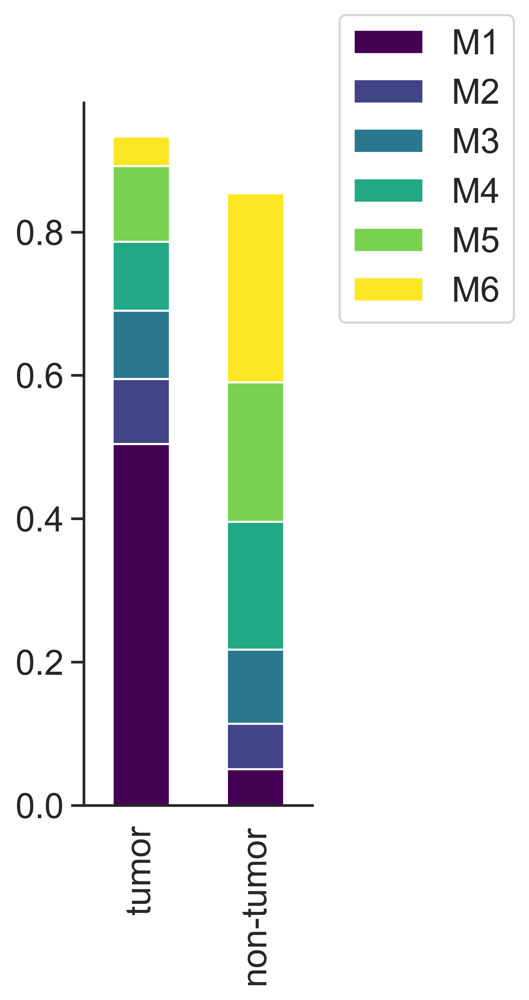

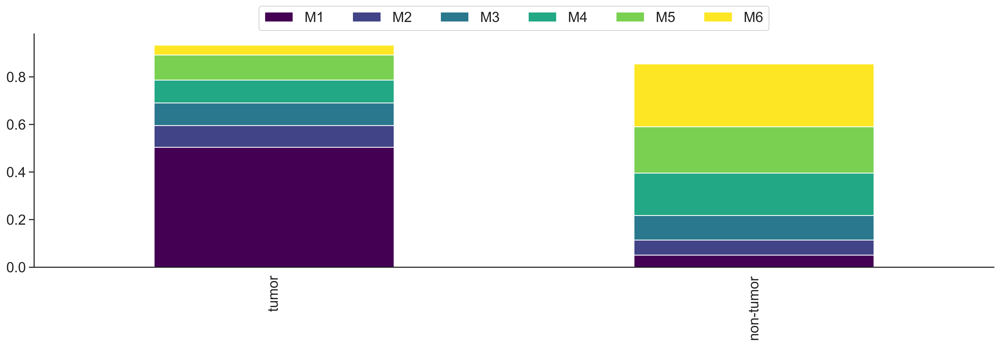

In [58]:
averageLabeling = {fn:{} for fn in msis}
for index,row2 in peaklist.iterrows():
    if row2["for_paper"] > 0.5:
        inds = row2["inds"]
        for fn in msis:
            print(msis[fn].ppm)
            
            tmpLab = {}
            
            fig, axes = plt.subplots(1,len(inds),figsize=(len(inds),1))
            tmp = msis[fn].data_tensor[inds]
            isoTensor = SIMSIToolBox.normalizeTensor(tmp)
            col = 0
            for img in isoTensor:
                tmp = axes[col].imshow(img,cmap=colormap)
                ave = np.mean(img[msis[fn].imageBoundary > 0.5])
                tmpLab[row2["formula"] + "_M" + str(col)] = ave
                axes[col].set_xticks([])
                axes[col].set_yticks([])
                axes[col].set_title("M"+str(col),fontsize=5)
                if col == len(isoTensor) - 1:
                    cbar = plt.colorbar(tmp, ax=axes[col],shrink=0.5)
                    tmp.set_clim(0.0,1.0)
                    cbar.ax.tick_params(labelsize=3)
                col += 1
            
            plt.tight_layout()
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_iso_all.png")

            tmp = msis[fn].data_tensor[inds]
            isoTensor = SIMSIToolBox.normalizeTensor(tmp)
            maxLim = 1.0
            counter = 0
            for img in isoTensor:
                norm = plt.Normalize(vmin=0, vmax=maxLim)
                norm = colormap(norm(img))
                for row in range(norm.shape[0]):
                    for col in range(norm.shape[1]):
                        if msis[fn].imageBoundary[row,col] < .5:
                            norm[row,col,3] = 0
                plt.imsave(datadir + fn.replace(".imzML","/") + row2["formula"] + "_M" + str(counter) +".png",norm)#,cmap=colormap)
                counter += 1
            
            plt.figure()
            SIMSIToolBox.showImage(img,cmap = colormap)
            plt.clim(0,maxLim)
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_M" + str(counter-1) +"_withColorBar.png")
            plt.close()


            tmp = msis[fn].data_tensor[inds]    
            poolSize = np.sum(tmp,axis=0)
            meanInt = np.mean(msis[fn].tic_image[msis[fn].imageBoundary > 0.5])
            poolSize = poolSize / msis[fn].tic_image
            poolSize = poolSize * meanInt
            poolSize[msis[fn].imageBoundary < 0.5] = 0.0
            plt.figure()
            
            SIMSIToolBox.showImage(poolSize,cmap = colormap)
            maxLim = np.max(poolSize)
            plt.clim(0,maxLim)
            norm = plt.Normalize(vmin=0, vmax=maxLim)
            norm = colormap(norm(poolSize))
            for row in range(norm.shape[0]):
                for col in range(norm.shape[1]):
                    if msis[fn].imageBoundary[row,col] < .5:
                        norm[row,col,3] = 0
            plt.imsave(datadir + fn.replace(".imzML","/") + row2["formula"] + "_pool.png",norm)#,cmap=colormap)
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_pool_with_colorbar.png")

            box1 = boxBoundaries[fn]["i"]
            box2 = boxBoundaries[fn]["c"]
                    
            norm = addBox(*box1[1],*box1[0],(1.0,0,0,1.0),norm)
            norm = addBox(*box2[1],*box2[0],(1.0,0,0,1.0),norm)

            plt.imsave(datadir + fn.replace(".imzML","/") + row2["formula"] + "_boxed_pool.png",norm)#,cmap=colormap)

            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_pool_with_colorbar.png")

            sb.set_theme(style="white",font_scale=1.8)

            df = extractLabelingPattern(isoTensor,*box1[1],*box1[0])

            maxLabeling = 1.0

            fig,ax = plt.subplots(figsize=(5,4))

            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)

            sb.barplot(data=df,x="isotopologue",y="Isotopologue Fraction",capsize=.1,color="dimgrey",errwidth=1.5)
            plt.ylim((0,maxLabeling))
            plt.xlabel("")
            plt.tight_layout()
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_box1_labeling_bar.png")

            fig,ax = plt.subplots(figsize=(5,4))
            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)

            df2 = extractLabelingPattern(isoTensor,*box2[1],*box2[0])

            sb.barplot(data=df2,x="isotopologue",y="Isotopologue Fraction",capsize=.1,color="dimgrey",errwidth=1.5)
            plt.ylim((0,0.5))
            plt.xlabel("")
            plt.tight_layout()
            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_box2_labeling_bar.png")

            sb.set_theme(font_scale=1.5,style={'ytick.left': True})

            fig,ax = plt.subplots(figsize=(5,7))

            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)

            df = extractLabelingPatternForStacked(isoTensor,*box1[1],*box1[0])
            df = df.rename(mapper={"Isotopologue Fraction":"tumor"},axis=1)

            df2 = extractLabelingPatternForStacked(isoTensor,*box2[1],*box2[0])
            df2 = df2.rename(mapper={"Isotopologue Fraction":"non-tumor"},axis=1)

            df = pd.concat((df,df2),axis=1,ignore_index=False).transpose()

            df = df[[x for x in df.columns.values if x != "M0"]]

            df.plot(kind='bar', stacked=True,ax=ax,cmap="viridis")

            plt.legend(loc="upper center", bbox_to_anchor=(1.5, 1.15) )

            #plt.yticks([0.0,0.05,0.1,0.15,0.2,0.25,0.30],rotation=90)

            plt.tight_layout()

            plt.savefig(datadir + fn.replace(".imzML","/") + row2["formula"] + "_labeling_stacked.png")

            fig,ax = plt.subplots(figsize=(20,5))

            df.plot(kind='bar', stacked=True,ax=ax,cmap="viridis")

            plt.legend(loc="upper center", bbox_to_anchor=(.5, 1.15) ,ncol=len(df.columns))

            #plt.colorbar()

            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)

            plt.savefig(datadir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_labeling_stacked_legend.png")


            for key,val in tmpLab.items():
                averageLabeling[fn][key] = np.mean(val)
    
    

In [42]:
pkl.dump([peaklist,msis,fluxImages],open(datadir + "processed_data.pkl","wb"))

In [52]:
[peaklist,msis,fluxImages] = pkl.load(open(datadir + "processed_data.pkl","rb"))

In [60]:
averageLabeling = pd.DataFrame.from_dict(averageLabeling,orient="index")
averageLabeling

,C16H32O2_M0,C16H32O2_M1,C16H32O2_M2,C16H32O2_M3,C16H32O2_M4,C16H32O2_M5,C16H32O2_M6,C16H32O2_M7,C16H32O2_M8,C16H32O2_M9,...,C18H36O2_M16,C18H36O2_M17,C18H36O2_M18,C6H9NO5_M0,C6H9NO5_M1,C6H9NO5_M2,C6H9NO5_M3,C6H9NO5_M4,C6H9NO5_M5,C6H9NO5_M6
20221026_mt_tumor_brain4-1_11E_13C_10um_70-560mz Analyte 1_1_recal.imzML,0.892241,0.015469,0.003274,0.001558,0.010404,0.003434,0.007124,0.005208,0.010421,0.007095,...,0.002426,0.000714,0.000769,0.157339,0.021113,0.059826,0.100875,0.180795,0.235931,0.244122
20221028_mt_tumor_brain4-2_12B_13C_10um_70-560mz Analyte 1_1_recal.imzML,0.841842,0.014216,0.010533,0.006140,0.023731,0.008142,0.011834,0.007997,0.012370,0.008672,...,0.003101,0.001076,0.001164,0.177216,0.065892,0.084655,0.111895,0.163195,0.198108,0.199039
20221031_mt_tumor_brain4-4_13D_13C_10um_70-560mz Analyte 1_1_recal.imzML,0.809039,0.012283,0.004955,0.002833,0.026007,0.007344,0.012195,0.009569,0.017799,0.013152,...,0.004116,0.001137,0.001231,0.150814,0.071868,0.059982,0.102599,0.175934,0.200705,0.238097


In [61]:
averageLabeling.to_csv(datadir + "average_labeling.csv")